# ERCOT Generation Insights
All of the charts below are base upon publicly available data downloaded from ERCOT:
https://www.ercot.com/gridinfo/generation/

ERCOT does not separate sources into base vs peaker plants, so I just picked something.
Opinionated fuel mappings are below.

In [1]:
import pandas as pd

In [2]:
FUEL_HYDRO = 'Hydro'
FUEL_SOLAR = 'Solar'
FUEL_WIND = 'Wind'
FUEL_GAS_CC = 'Gas-CC'
FUEL_GAS = 'Gas'
FUEL_COAL = 'Coal'
FUEL_BIOMASS = 'Biomass'
FUEL_NUCLEAR = 'Nuclear'
FUEL_TYPE_CLEAN = 'Clean'
FUEL_TYPE_FOSSIL = 'Fossil'
FUEL_TYPE_RENEWABLE = 'Renewable'
FUEL_TYPE_OTHER = 'Other'


FUEL_TYPE_MAPPINGS = {
    FUEL_HYDRO: FUEL_TYPE_RENEWABLE,
    FUEL_SOLAR: FUEL_TYPE_RENEWABLE,
    FUEL_WIND: FUEL_TYPE_RENEWABLE,
    FUEL_BIOMASS: FUEL_TYPE_FOSSIL,
    FUEL_COAL: FUEL_TYPE_FOSSIL,
    FUEL_GAS: FUEL_TYPE_FOSSIL,
    FUEL_GAS_CC: FUEL_TYPE_FOSSIL,
    FUEL_NUCLEAR: FUEL_TYPE_CLEAN,
}
def get_fuel_type(fuel):
    return FUEL_TYPE_MAPPINGS.get(fuel, FUEL_TYPE_OTHER)

LOAD_TYPE_BASE = 'Base'
LOAD_TYPE_PEAKER = 'Peaker'
LOAD_TYPE_OTHER = 'Other'

LOAD_TYPE_MAPPINGS = {
    FUEL_HYDRO: LOAD_TYPE_BASE,
    FUEL_SOLAR: LOAD_TYPE_PEAKER,
    FUEL_WIND: LOAD_TYPE_PEAKER,
    FUEL_BIOMASS: LOAD_TYPE_BASE,
    FUEL_COAL: LOAD_TYPE_BASE,
    FUEL_GAS: LOAD_TYPE_BASE,
    FUEL_GAS_CC: LOAD_TYPE_PEAKER,
    FUEL_NUCLEAR: LOAD_TYPE_BASE,
}
    
def get_load_type(fuel):
    return LOAD_TYPE_MAPPINGS.get(fuel, LOAD_TYPE_OTHER)
import json
print('Fuel Type Mappings', json.dumps(FUEL_TYPE_MAPPINGS, indent=True, sort_keys=True))
print('Load Type Mappings', json.dumps(LOAD_TYPE_MAPPINGS, indent=True, sort_keys=True))

Fuel Type Mappings {
 "Biomass": "Fossil",
 "Coal": "Fossil",
 "Gas": "Fossil",
 "Gas-CC": "Fossil",
 "Hydro": "Renewable",
 "Nuclear": "Clean",
 "Solar": "Renewable",
 "Wind": "Renewable"
}
Load Type Mappings {
 "Biomass": "Base",
 "Coal": "Base",
 "Gas": "Base",
 "Gas-CC": "Peaker",
 "Hydro": "Base",
 "Nuclear": "Base",
 "Solar": "Peaker",
 "Wind": "Peaker"
}


In [3]:
from datetime import datetime
dateparse = lambda x: datetime.strptime(x, '%m/%d/%Y')
decimalparse = lambda x: float(x.replace(',',''))


def get_df(year: int, month: int):
    df = pd.read_table(
        f'ERCOT/IntGenByFuel{year}{month:02d}.tsv',
        usecols=['Date','Fuel','Total', 'Settlement Type'],
        converters={'Date':dateparse,'Total':decimalparse},
    )
    
        # Find daily total
    alltotal=df.groupby('Date').sum()
    alltotal['Fuel']='ALL SOURCES'
    alltotal['Settlement Type']='Combined'
    alltotal = alltotal.reset_index(drop=False)
    newdf = pd.concat([df, alltotal])

    maxdf = newdf.groupby('Date').max()['Total'].reset_index(drop=False)
    
    newdf = newdf.merge(maxdf, left_on='Date', right_on='Date', suffixes=['', '_y']).rename({'Total_y': 'DailyMax'}, axis=1)

    newdf = newdf.assign(pct=lambda x: x['Total'] / x['DailyMax'])
    
    newdf['FuelType'] = newdf['Fuel'].apply(get_fuel_type)
    newdf['LoadType'] = newdf['Fuel'].apply(get_load_type)
    newdf['SourceType'] = newdf['LoadType'] + ' ' + newdf['FuelType']
    newdf.loc[newdf['SourceType'] == 'Other Other', 'SourceType'] = 'Other'
    # Aggregate by month?
    # newdf = newdf.groupby('Fuel').sum().reset_index(drop=False)
    # newdf['Date'] = pd.to_datetime(f'{year}-{month:02d}')

    return newdf

In [4]:
all_dfs = []
for year in (2020, 2021, 2022):
    for month in list(range(1, 13)):
        newdf = get_df(year, month)
        all_dfs.append(newdf)
        if year == 2022 and month == 5:
            break
newdf = pd.concat(all_dfs)
# Ignore incomplete weeks.
newdf = newdf.query('Date < "2022-05-29"')
newdf['Total'] /= 1000

In [5]:
import altair as alt
alt.data_transformers.disable_max_rows()
alt.renderers.enable('mimetype')

RendererRegistry.enable('mimetype')

In [6]:
date_range=f'{newdf.Date.min().strftime("%Y-%m")}-{newdf.Date.max().strftime("%Y-%m")}'
width=1920/2
height=1080/2

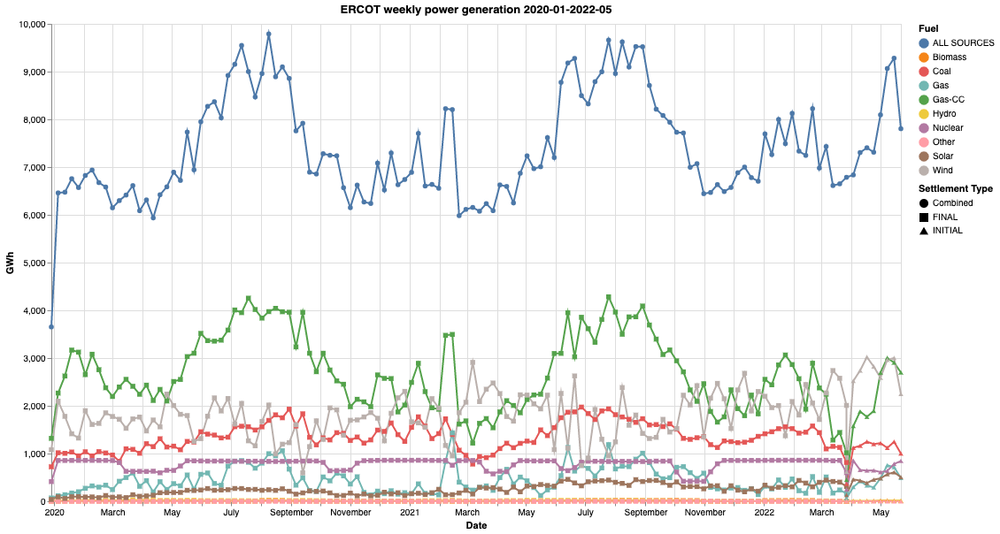

In [7]:
chart = alt.Chart(
    newdf
).transform_timeunit(
    Date='yearweek(Date)'
).transform_aggregate(
    Total='sum(Total)',
    groupby=['Date', 'Fuel', 'Settlement Type', 'FuelType', 'SourceType']
).mark_line().encode(
    x='Date:T',
    y=alt.Y('Total:Q', title='GWh', scale=alt.Scale(domainMin=0)),
    color='Fuel:N',
    tooltip=['Date', 'Fuel', 'Total', 'Settlement Type', 'FuelType', 'SourceType'],
    shape='Settlement Type',
).properties(
    title=f'ERCOT weekly power generation {date_range}',
    width=width,
    height=height,
)
display(chart)

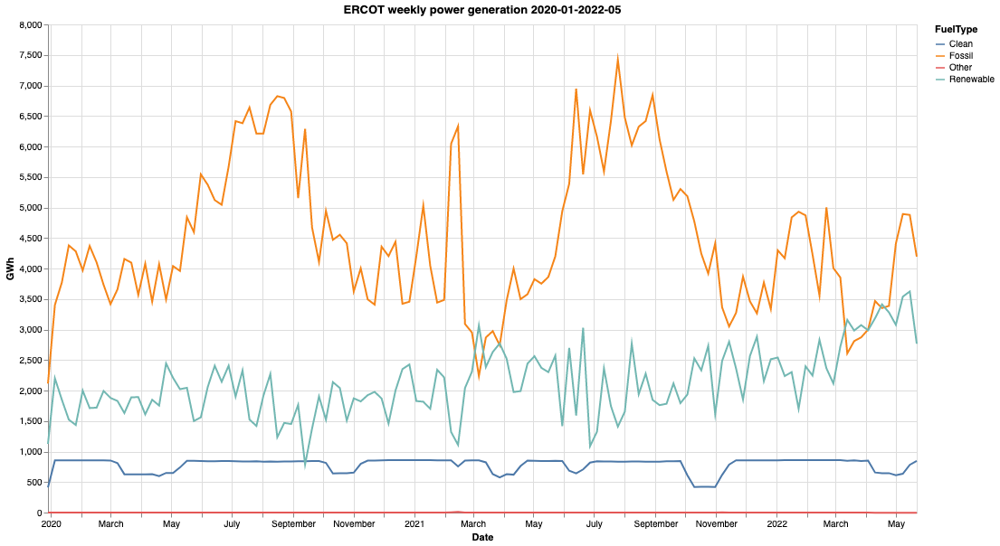

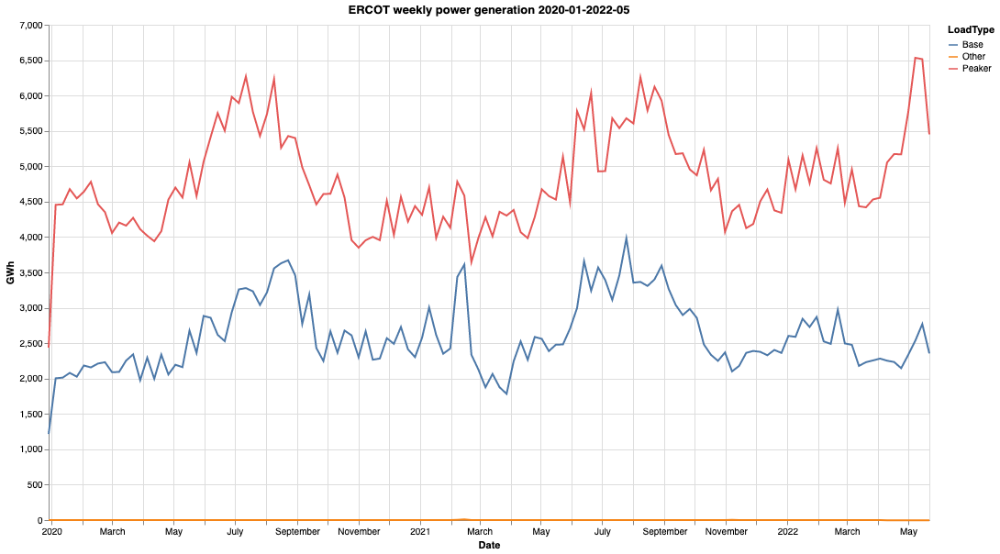

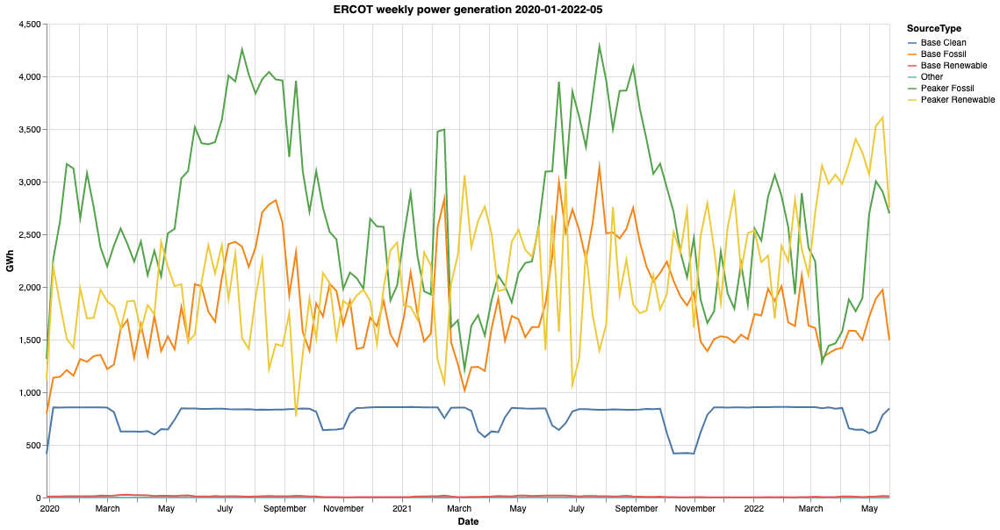

In [8]:
for facet in ('FuelType', 'LoadType', 'SourceType'):
    chart = alt.Chart(
        newdf.query('Fuel != "ALL SOURCES"').groupby(['Date', 'FuelType', 'LoadType', 'SourceType']).sum().reset_index().round(1)
    ).transform_timeunit(
        Date='yearweek(Date)'
    ).transform_aggregate(
        Total='sum(Total)',
        groupby=['Date', 'Fuel', facet],
    ).mark_line().encode(
        x='Date:T',
        y=alt.Y('Total:Q', title='GWh', scale=alt.Scale(domainMin=0)),
        color=facet,
        tooltip=['Date', facet, 'Total']
    ).properties(
        title=f'ERCOT weekly power generation {date_range}',
        width=width,
        height=height,
    )
    display(chart)

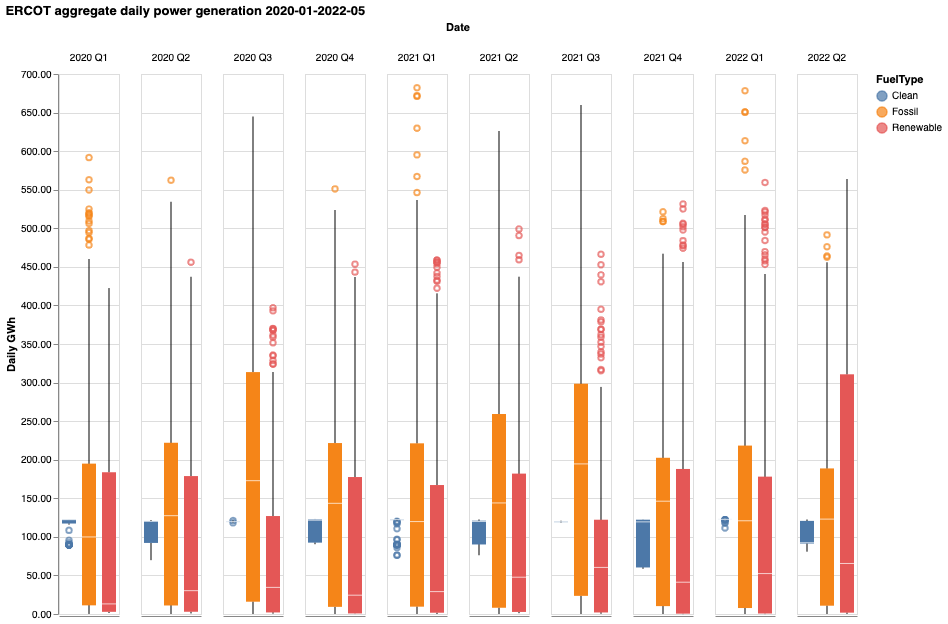

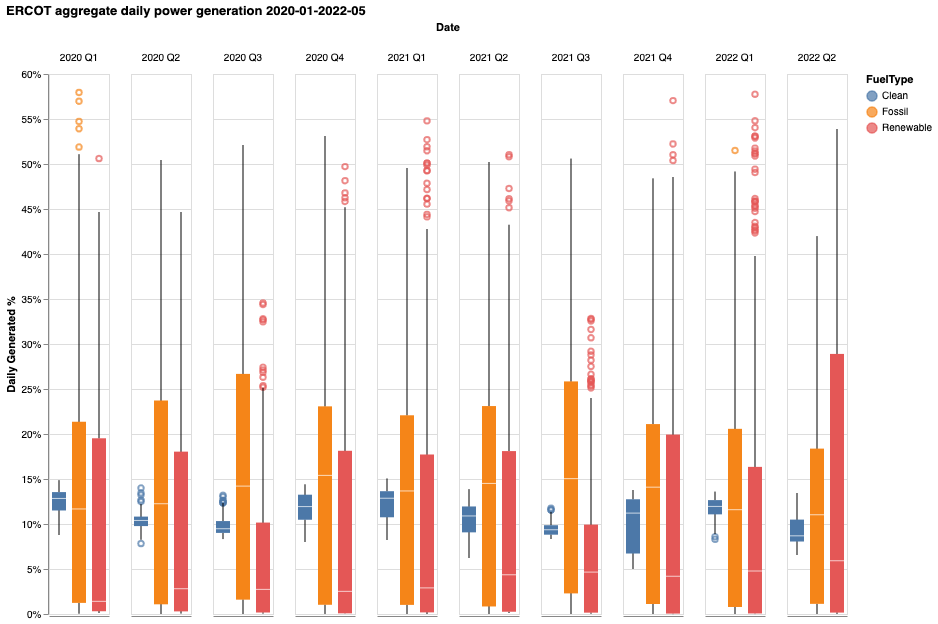

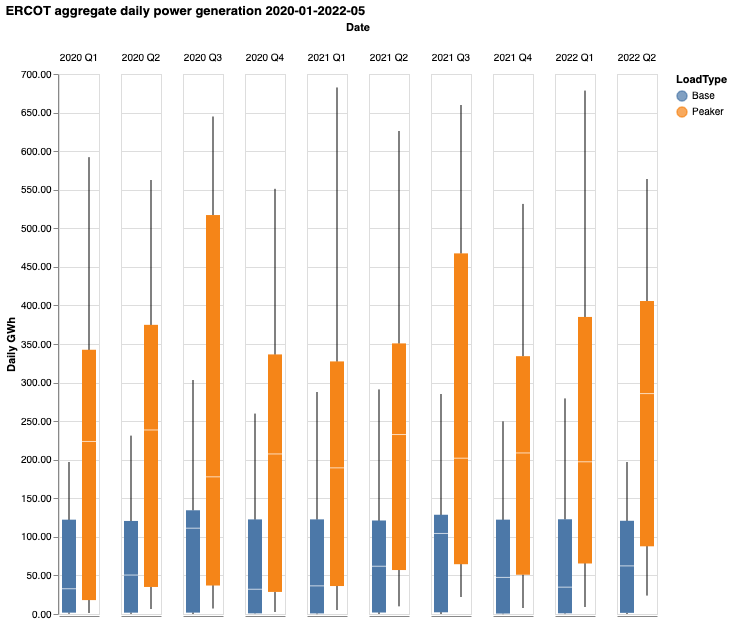

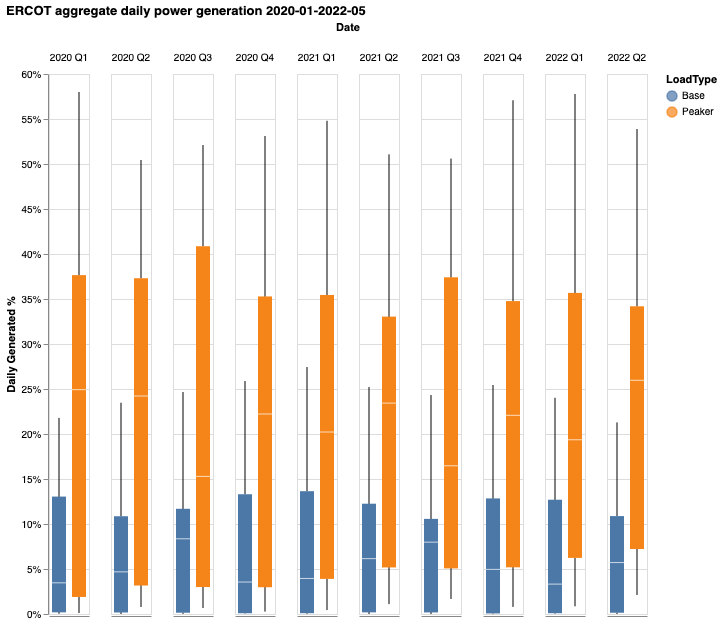

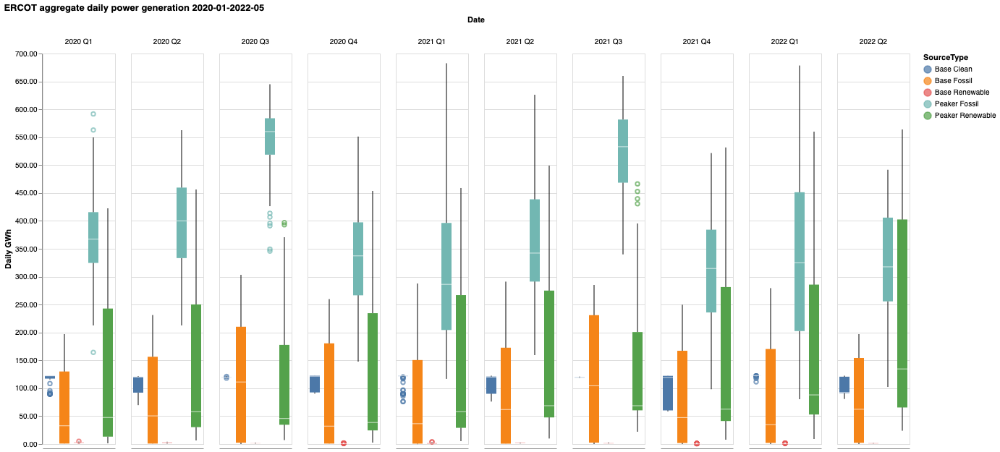

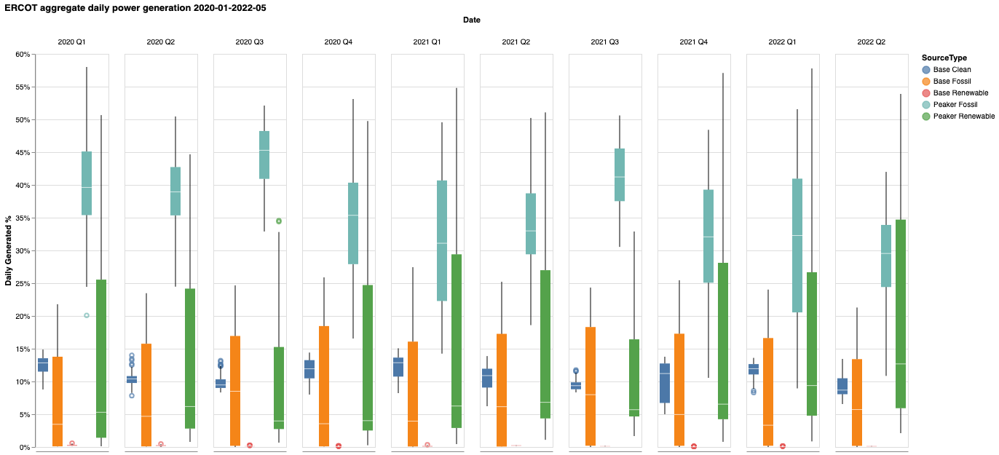

In [9]:
for facet in ('FuelType', 'LoadType', 'SourceType'):
    for y in (
        alt.Y(
            'Total:Q', title='Daily GWh',
            scale=alt.Scale(domainMin=0), axis=alt.Axis(format='0.2f'),
        ),
        alt.Y(
            'pct:Q', title='Daily Generated %', axis=alt.Axis(format='%'),
        ),
    ):
        chart = alt.Chart(
            newdf.query('Fuel not in ("ALL SOURCES", "Other")')
        ).mark_boxplot(
        ).encode(
            x=alt.X(f'{facet}:N', axis=alt.Axis(labels=False, ticks=False), title=None),
            column=alt.Column('yearquarter(Date):T', title='Date'),
            y=y,
            color=f'{facet}:N',
            tooltip=[
                f'{facet}',
                'Date',
                alt.Tooltip('Total', format='d'), 
                alt.Tooltip('pct', format='.2%'), 
            ]
        ).properties(
            title=f'ERCOT aggregate daily power generation {date_range}',
            # width=width,
            height=height,
        )
        display(chart)